<a href="https://colab.research.google.com/github/chenwh0/Natural-Language-Processing-work/blob/main/FinalProject/LLMQuerySQLUsingLangGraph.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Integrating intelligence into geospatial Big data searches**
## *Initial steps to (Convert Natural language to SQL)*
1. Select DataBase engine
2. Select model fine-tuned for this task
3. Define required LangGraph nodes
* **Query assistant** - Takes natural language, convert to SQL using LLM
* **Query cleanup** - Clean LLM"s generated SQL of syntactic errors
* **Query executor** - Use DB engine & execute generated query
* **Output parser** - Parse/format query result
4. Add conditional edges to handle exceptions.

## *Further processing steps (Recommend & summarize)*
5. Encode corpus of column names with a brief description on each name
6. Prompt LLM to generate text that is relevant to user's prompt
7. Encode generated text and compare against corpus
8. Extract data attributes that have highest cosine similarity scores
9. Prompt LLM to summarize all retrieved data (actual answer to prompt and recommended relevant data values)

## References

* [Introduction to LangGraph: A Beginner’s Guide](https://medium.com/@cplog/introduction-to-langgraph-a-beginners-guide-14f9be027141)
* [LangGraph(Part-1): Automate complex workflows using GenAI](https://medium.com/@sitabjapal03/langgraph-part-1-automate-complex-workflows-using-genai-59bb8dc462aa)
* [LangGraph(Part-2): Querying a SQL DB in Natural Language](https://medium.com/@sitabjapal03/langgraph-part-2-querying-a-sql-db-in-natural-language-6328c5882858)
* [Build an Agentic Workflow for your BigQuery data using LangGraph and Gemini
](https://medium.com/google-cloud/build-an-agentic-workflow-for-your-bigquery-data-using-langgraph-and-gemini-947d0a951a45)

# **Installs & Imports**

In [ ]:
!pip install langgraph grandalf langchain-experimental langchain_community langchain-cohere -q

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 155.4/155.4 kB 6.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 41.8/41.8 kB 2.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 209.2/209.2 kB 11.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.5/2.5 MB 60.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.3/42.3 kB 2.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 295.4/295.4 kB 18.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.8/45.8 kB 2.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.8/56.8 kB 3.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 64.7/64.7 kB 2.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.5/3.5 MB 48.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.9/50.9 kB 1.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.6/207.6 kB 11.7 MB/s eta 0:00:00
ERROR: pip's dependency resolver does not currently tak

In [ ]:
import pandas

# Library to build LangGraphs
from typing import Dict, TypedDict, Optional
from langgraph.graph import StateGraph, MessagesState, END
from langchain_core.messages import HumanMessage, AIMessage #  in HumanMessage, LLM response to our call will output as AIMessage

# Library to display LangGraphs
from IPython.display import Image, display

# Libraries for API keys
from google.colab import userdata
import os

# Libraries to create SQL LangGraph application
from sqlalchemy import create_engine,Table, MetaData, Column, String, Date, Integer, Float, text
from tqdm import tqdm
from langchain_experimental.sql import SQLDatabaseChain
from langgraph.graph import MessagesState
from langchain_community.utilities import SQLDatabase
from langchain_cohere import ChatCohere

# Libraries to process output
import ast

# Libraries for RAG
from sentence_transformers import SentenceTransformer, util
import torch
import json

# Summarize
from langchain.schema import SystemMessage

# Libraries for logging
import logging
import os

#
from concurrent.futures import ThreadPoolExecutor, TimeoutError
import time

In [ ]:
os.environ["HUGGINGFACEHUB_API_TOKEN"] = userdata.get("HF_TOKEN")
os.environ["COHERE_API_KEY"] = userdata.get("cohereAPI")

# **Data setup**

## Database setup

In [ ]:
# Existing database
DATABASE_URI = "sqlite:////content/drive/MyDrive/MO_geoARK_Oct2024_DB.db"

# Create the SQLAlchemy engine
db_engine = create_engine(DATABASE_URI)

# Test connection
with db_engine.connect() as conn:
    result = conn.execute(text("SELECT name FROM sqlite_master WHERE type='table';"))
    print("Tables:", result.fetchall())
SQL_DB = SQLDatabase(db_engine)

Tables: [('MO_geoARK',)]


In [ ]:
file_path = "./drive/MyDrive/MO_geoARK_Oct2024.csv"
geoARK_dataframe = pandas.read_csv(file_path)
print("Shape:", geoARK_dataframe.shape)
print()
geoARK_dataframe.head()

## Corpus embeddings setup

In [ ]:
COLUMN_DESCRIPTIONS = {
    "OBJECTID": "Unique identifier for each feature",
    "FID_L48_All_Pt_Blk1020ZipHUC_TH": "Feature identifier related to block, zip code, and HUC data with Thiessen polygons",
    "FID_L48_All_Pt_Blk1020ZipHUC_Mer": "Feature identifier related to block, zip code, and HUC data with Merge polygons",
    "GRID_ID": "Grid identifier",
    "FID_Block20": "Feature identifier for 2020 Census Block",
    "TotalArea": "Total area",
    "PctWater": "Percentage of water area",
    "State20": "State FIPS code (2020 Census)",
    "County20": "County FIPS code (2020 Census)",
    "Tract20": "Census Tract code (2020 Census)",
    "BGroup20": "Block Group code (2020 Census)",
    "Block20": "Block code (2020 Census)",
    "FID_Block10": "Feature identifier for 2010 Census Block",
    "TotalArea_1": "Total area (2010 Census)",
    "PctWater_1": "Percentage of water area (2010 Census)",
    "ST10": "State FIPS code (2010 Census)",
    "Cnty10": "County FIPS code (2010 Census)",
    "Trct10": "Census Tract code (2010 Census)",
    "BG10": "Block Group code (2010 Census)",
    "Blk10": "Block code (2010 Census)",
    "FID_ZipCode_bnd": "Feature identifier for Zip Code boundary",
    "OBJECTID_1": "Another unique identifier",
    "ZIP_CODE": "ZIP Code",
    "PO_NAME": "Post Office Name",
    "STATE": "State abbreviation",
    "ZipAreaSqM": "Zip Code area in square meters",
    "FID_WBD_HUC12_Copy": "Feature identifier for HUC12 watershed boundary",
    "loaddate": "Date data was loaded",
    "states": "State name",
    "huc12": "12-digit Hydrologic Unit Code",
    "name": "Name of the feature or area",
    "hutype": "Hydrologic Unit Type",
    "humod": "Hydrologic Unit Modifier",
    "tohuc": "To HUC identifier",
    "noncontributingareasqkm": "Non-contributing area in square kilometers",
    "HUC2": "2-digit Hydrologic Unit Code",
    "HUC4": "4-digit Hydrologic Unit Code",
    "HUC6": "6-digit Hydrologic Unit Code",
    "HUC8": "8-digit Hydrologic Unit Code",
    "HUC10": "10-digit Hydrologic Unit Code",
    "HUC12sqkm": "HUC12 area in square kilometers",
    "POINT_X": "X coordinate of a point",
    "POINT_Y": "Y coordinate of a point",
    "FID_L48_All_points_CreateThies_Clip": "Feature identifier related to Thiessen polygon creation",
    "Input_FID": "Input Feature Identifier",
    "ThiesArea": "Area of Thiessen polygon",
    "FID_L48_All_points_CreateThies_Clip_1": "Another feature identifier related to Thiessen polygon creation",
    "Input_FID_1": "Another Input Feature Identifier",
    "ThiessenArea": "Area of Thiessen polygon",
    "ParksEdist": "Euclidean distance to Parks",
    "HospEDist": "Euclidean distance to Hospitals",
    "UrgCareEDist": "Euclidean distance to Urgent Care facilities",
    "PowerLineDen": "Power Line Density",
    "F_Airport": "Flag indicating presence of Airport",
    "D_Airport": "Distance to Airport",
    "F_Biodsl": "Flag indicating presence of Biodiesel facility",
    "D_Biodsl": "Distance to Biodiesel facility",
    "F_ChldCare": "Flag indicating presence of Child Care facility",
    "D_ChldCare": "Distance to Child Care facility",
    "F_CnsMinOp": "Flag indicating presence of Construction Mineral Operation",
    "D_CnsMinOp": "Distance to Construction Mineral Operation",
    "F_CrshStOp": "Flag indicating presence of Crushing Station Operation",
    "D_CrshStOp": "Distance to Crushing Station Operation",
    "F_FeMines": "Flag indicating presence of Ferroalloy Mines",
    "D_FeMines": "Distance to Ferroalloy Mines",
    "F_EMS": "Flag indicating presence of Emergency Medical Services",
    "D_EMS": "Distance to Emergency Medical Services",
    "F_FeMtPPln": "Flag indicating presence of Ferroalloy Smelting Plant",
    "D_FeMtPPln": "Distance to Ferroalloy Smelting Plant",
    "F_AgrMinOp": "Flag indicating presence of Aggregate Mineral Operation",
    "D_AgrMinOp": "Distance to Aggregate Mineral Operation",
    "F_NonFeMtM": "Flag indicating presence of Nonferrous Metal Mine",
    "D_NonFeMtM": "Distance to Nonferrous Metal Mine",
    "F_NonFeMtP": "Flag indicating presence of Nonferrous Metal Processing Plant",
    "D_NonFeMtP": "Distance to Nonferrous Metal Processing Plant",
    "F_MineMnrl": "Flag indicating presence of Mining Minerals facility",
    "D_MineMnrl": "Distance to Mining Minerals facility",
    "F_MiscInd": "Flag indicating presence of Miscellaneous Industry",
    "D_MiscInd": "Distance to Miscellaneous Industry",
    "F_Abrasive": "Flag indicating presence of Abrasive facility",
    "D_Abrasive": "Distance to Abrasive facility",
    "F_UrnVandD": "Flag indicating presence of Used Oil Recycling/Disposal facility",
    "D_UrnVandD": "Distance to Used Oil Recycling/Disposal facility",
    "F_SWLndfl": "Flag indicating presence of Solid Waste Landfill",
    "D_SWLndfl": "Distance to Solid Waste Landfill",
    "NEAR_ANGLE": "Nearest Angle",
    "F_PowLines": "Flag indicating presence of Power Lines",
    "D_PowLines": "Distance to Power Lines",
    "F_PowPlnts": "Flag indicating presence of Power Plants",
    "D_PowPlnts": "Distance to Power Plants",
    "F_SubStn": "Flag indicating presence of Electrical Substation",
    "D_SubStn": "Distance to Electrical Substation",
    "F_PubHealth": "Flag indicating presence of Public Health facility",
    "D_PubHealth": "Distance to Public Health facility",
    "F_PbSchools": "Flag indicating presence of Public Schools",
    "D_PbSchools": "Distance to Public Schools",
    "F_Uni": "Flag indicating presence of University",
    "D_Uni": "Distance to University",
    "F_PubTrans": "Flag indicating presence of Public Transportation",
    "D_PubTrans": "Distance to Public Transportation",
    "F_Worship": "Flag indicating presence of Place of Worship",
    "D_Worship": "Distance to Place of Worship",
    "F_Tornado": "Flag indicating presence of Tornado",
    "D_Tornado": "Distance to Tornado",
    "F_ER_TRI": "Flag indicating presence of Toxics Release Inventory site",
    "D_ER_TRI": "Distance to Toxics Release Inventory site",
    "F_ER_TSCA": "Flag indicating presence of Toxic Substances Control Act site",
    "D_ER_TSCA": "Distance to Toxic Substances Control Act site",
    "F_OilRef": "Flag indicating presence of Oil Refinery",
    "D_OilRef": "Distance to Oil Refinery",
    "F_OilRefPl": "Flag indicating presence of Oil Refinery Pipeline",
    "D_OilRefPl": "Distance to Oil Refinery Pipeline",
    "Field": "Field data",
    "FID_VHA": "Feature identifier for Veteran Health Administration facility",
    "DIST_VHA": "Distance to Veteran Health Administration facility"
}
CORPUS_KEYS = list(COLUMN_DESCRIPTIONS.keys())

In [ ]:
ENCODER_NAME = "all-MiniLM-L6-v2" # Load embedding model (small, fast)
ENCODER = SentenceTransformer(ENCODER_NAME)
TOP_K = 5

# Encode corpus
corpus = list(COLUMN_DESCRIPTIONS.items())
CORPUS_EMBEDDINGS = ENCODER.encode(corpus, convert_to_tensor=True)
if CORPUS_EMBEDDINGS.dim() != 2:
    CORPUS_EMBEDDINGS = CORPUS_EMBEDDINGS.unsqueeze(0)  # Convert to 2D if it has another dimension
CORPUS_EMBEDDINGS = util.normalize_embeddings(CORPUS_EMBEDDINGS)

## LLM model setup

In [ ]:
LLM_NAME = "command-r-plus-08-2024"
TEMPERATURE = 1 # or 0.5
LLM = ChatCohere(model=LLM_NAME, max_tokens=100, temperature=TEMPERATURE)

# **LangGraph functions setup**

In [ ]:
# class GraphState(TypedDict):
#     input: Optional[str] = None
#     classification: Optional[str] = None
#     output: Optional[str] = None

def stream_node_processes(graph: StateGraph, inputs: Dict) -> None:
    for node_output in graph.stream(inputs):
        for node_name, output in node_output.items():
            print("Node:", node_name)
            print(output)
        print("-------------------------")

def draw_graph(graph: StateGraph) -> None:
    try:
        display(Image(graph.get_graph(xray=True).draw_mermaid_png()))
    except Exception as error:
        print(error)
        print("\n\nAlternative ASCII graph drawing...")
        graph.get_graph().print_ascii()
        pass

# **Logger functions setup**

In [ ]:
def setup_logger(log_file="experiment_log.txt", level=logging.INFO):
    # Ensure directory exists
    os.makedirs(os.path.dirname(log_file) or ".", exist_ok=True)

    # Configure global logging
    logging.basicConfig(
        level=level,
        format="%(asctime)s | %(levelname)s | %(funcName)s | %(message)s",
        handlers=[
            logging.FileHandler(log_file, mode="a", encoding="utf-8"),
            logging.StreamHandler()  # also prints to console
        ]
    )

    # Optional: suppress noisy library logs (e.g., from transformers, matplotlib)
    logging.getLogger("matplotlib").setLevel(logging.WARNING)
    logging.getLogger("urllib3").setLevel(logging.WARNING)
    logger = logging.getLogger()

# **Subgraph 1 setup**

In [ ]:
# else, it will create and execute query internally which is sometime error prone
def generate_query(state: MessagesState):
    sql_chain = SQLDatabaseChain.from_llm(LLM, SQL_DB, return_sql=True, return_direct=True) # Forcefully made return_sql=True, return_direct=True to get the generated SQL
    messages = state["messages"]
    response = sql_chain.invoke(messages)
    generated_sql = response["result"]
    state["messages"] = [generated_sql]
    print(f"Node 1: Generating query...\nGenerated query: {generated_sql}")
    return state

# Query cleanup can be done using another LLM with a proper prompt but,
# in this case I am doing simple string manupulation as the model's output is
# almost correct
def clean_query(state: MessagesState):
    message = state["messages"][-1].content
    if message.strip().endswith("S"): # Remove trailing 'S' if present
        message = message.strip()[:-1]
    # More robust cleaning to remove markdown code block syntax
    cleaned_query = message.strip()
    if cleaned_query.startswith("```sql"):
        cleaned_query = cleaned_query[6:]
    if cleaned_query.endswith("```"):
        cleaned_query = cleaned_query[:-3]
    cleaned_query = cleaned_query.strip()
    state["messages"] = [cleaned_query]
    print(f"\n\nNode 2: Cleaning query...\nCleaned query: {cleaned_query}")
    return state

# Execute the generated query and extract or formmat output as per requirement
def execute_query(state: MessagesState):
    sql = state["messages"][-1].content
    with db_engine.begin() as connection:
        answer = connection.execute(text(sql)).fetchall()
    state["messages"] = [str(answer)]
    print(f"\n\nNode 3: Executing query...\nExecuted query: {str(answer)}")
    return state

# **Subgraph 2 setup**

In [ ]:
def decide_next_node(state):
    user_response = state.get("user_decision", "y").lower()
    condition = "summarize_and_recommend" if user_response == "y" else "get_direct_answer"
    if condition:
        print(f"\n\nNode 4: Deciding next node...\nFurther processing: summarize and recommend...")
    else:
        print(f"\n\nNode 4: Deciding next node...\nOutputting direct answer...")
    return {
        "_next": condition,
        "messages": state.get("messages",[])
    }

def convert_to_json(response):
    try:
        parsed = ast.literal_eval(response)
        if isinstance(parsed, list):
            parsed = parsed[0] if len(parsed) > 0 and isinstance(parsed[0], (list, tuple)) else parsed
        else:
            #logger.error(f"Invalid response type received: {type(response)}; expected list-like response.")
            raise ValueError("Response not list-like.")
    except Exception as e:
        #logger.error(f"Invalid response format: {e}")
        raise ValueError(f"Invalid response format: {e}")

    response_map_descriptions = {}
    for value, description_name in zip(parsed, COLUMN_DESCRIPTIONS.keys()):
        description = COLUMN_DESCRIPTIONS.get(description_name, "")
        response_map_descriptions[description_name] = {"value": value, "description": description}

    return response_map_descriptions

def query_recommender(state: MessagesState):
    natural_language_query = state["messages"][1].content # Get original prompt
    response_map_descriptions = convert_to_json(state["messages"][-1].content)
    recommend_query = f"Recommend other potentially relevant areas to study given User query: {natural_language_query}\nand data{response_map_descriptions}"
    messages = [
        SystemMessage(content="You're a query recommending assistant. Based on user query and data, identify other relevant areas of exploration."),
        HumanMessage(content=recommend_query)
    ]

    response = LLM.invoke(messages)
    response_map_descriptions = json.dumps(response_map_descriptions) # Convert to string
    print(f"\n\nNode 5: Recommending supplementary data attributes to look for...\nRecommendations: {response.content}")
    return {"messages": [AIMessage(response.content), HumanMessage(response_map_descriptions)]}

def recommendations_extractor(state: MessagesState):
    response_map_descriptions = state["messages"][-1].content
    response_map_descriptions = json.loads(response_map_descriptions) # Convert to json/dict
    recommendations = state["messages"][-2].content
    # Encode query & Compute cosine similarity between corpus & recommendation encodings
    recommendations_embeddings = ENCODER.encode([recommendations], convert_to_tensor=True)
    if recommendations_embeddings.dim() != 2:
        recommendations_embeddings = recommendations_embeddings.unsqueeze(0)  # Make it 2D if it's 1D
    recommendations_embeddings = util.normalize_embeddings(recommendations_embeddings) # Normalize
    hits = util.semantic_search(recommendations_embeddings, CORPUS_EMBEDDINGS, top_k=TOP_K)[0]
    top_k_key_values = "Fetched features and values:\n"
    # Top relevant results
    for hit in hits:
        key = CORPUS_KEYS[hit["corpus_id"]]
        value = response_map_descriptions.get(key, {}).get("value", "N/A")
        description = COLUMN_DESCRIPTIONS.get(key, "No description")
        top_k_key_values += f"{key} (relevance={hit['score']:3f}) ({description}) = {value}\n"
    print(f"\n\nNode 6: Fetching recommended data...\n{top_k_key_values}")
    return {"messages": [top_k_key_values]}


def summarizer(state: MessagesState):
    top_k_key_values = state["messages"][-1]
    summarize_query = f"Summarize features and values.\n{top_k_key_values}"

    messages = [
        SystemMessage(content="You're a data summarization assistant."),
        HumanMessage(content=summarize_query)
    ]

    response = LLM.invoke(messages)
    print(f"\n\nNode 7: Summarizing fetched data...\n{response.content}")
    return {"messages": [response.content]}

# **Main graph setup (Subgraph1 + Subgraph2)**

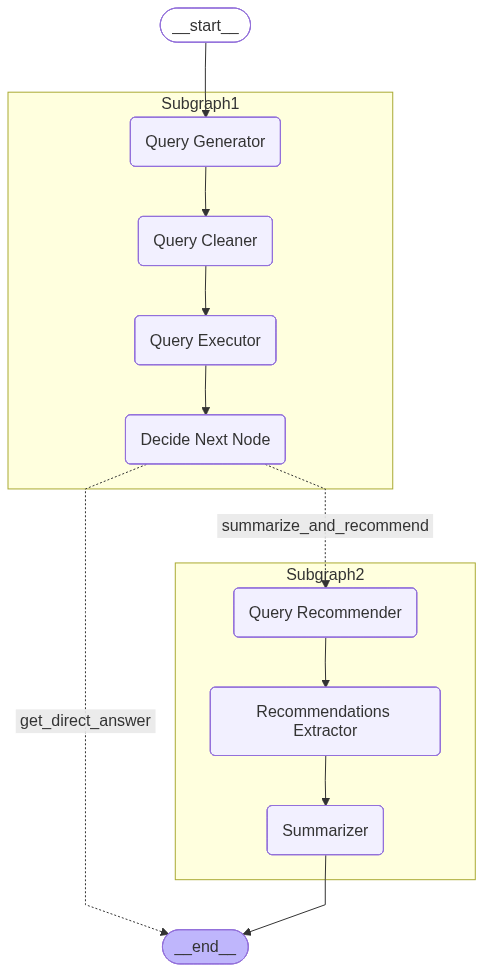

In [ ]:
# ------------------------
# 1. Subgraph 2: summary + recommendations
# ------------------------
subgraph2 = StateGraph(MessagesState)

subgraph2.add_node("Query Recommender", query_recommender)
subgraph2.add_node("Summarizer", summarizer)
subgraph2.add_node("Recommendations Extractor", recommendations_extractor)

subgraph2.set_entry_point("Query Recommender")
#subgraph2.add_edge("Query_Recommender", "Summarizer")
subgraph2.add_edge("Query Recommender", "Recommendations Extractor")
subgraph2.add_edge("Recommendations Extractor","Summarizer")
subgraph2.add_edge("Summarizer", END)

subgraph2_workflow = subgraph2.compile()

# ------------------------
# 2. Subgraph 1: query generation + execution + decision
# ------------------------
subgraph1 = StateGraph(MessagesState)

subgraph1.add_node("Query Generator", generate_query)
subgraph1.add_node("Query Cleaner", clean_query)
subgraph1.add_node("Query Executor", execute_query)
subgraph1.add_node("Decide Next Node", decide_next_node)

subgraph1.set_entry_point("Query Generator")
subgraph1.add_edge("Query Generator", "Query Cleaner")
subgraph1.add_edge("Query Cleaner", "Query Executor")
subgraph1.add_edge("Query Executor", "Decide Next Node")
subgraph1.add_edge("Decide Next Node", END)  # temporary, actual branch handled in main_graph

subgraph1_workflow = subgraph1.compile()

# ------------------------
# 3. Main graph: controls conditional branching between subgraphs
# ------------------------
main_graph = StateGraph(MessagesState)

main_graph.add_node("Subgraph1", subgraph1_workflow)
main_graph.add_node("Subgraph2", subgraph2_workflow)

main_graph.set_entry_point("Subgraph1")
main_graph.add_conditional_edges(
    "Subgraph1",
    lambda state: state.get("_next", "summarize_and_recommend"),  # safely extract _next from subgraph1 output
    {
        "summarize_and_recommend": "Subgraph2",
        "get_direct_answer": END
    }
)
main_graph.add_edge("Subgraph2", END)

main_graph_workflow = main_graph.compile()
draw_graph(main_graph_workflow)

# **Execute Workflow**

In [ ]:
natural_language_prompts = ["Which object is closest to VHA?",
                            "Return an object with the highest number of Oil Refineries around it.",
                            "Show the objects near a Nonferrous Metal Mine.",
                            "Child care facility in Columbia",
                            "Find public health facilities within 50 km of Columbia, Missouri.",
                            "Which region shows the lowest average distance to hospitals?",
                            "List attributes for the 2 objects near Miscellaneous Industry."]

In [ ]:
results = []

for prompt_num, prompt in enumerate(natural_language_prompts):
    inputs =  { "messages": [ {"role": "system", "content": "Always return entire object(s) row."}, {"role": "human", "content": prompt} ],
            "user_decision": "y"  # or "n"
        }
    for generation_trial_num in range(3):
        logfile_name = f"prompt{prompt_num}_generation{generation_trial_num}_logfile.txt"
        logfile_path = f"./drive/MyDrive/NLP_and_geospatial_Big_Data/logfiles/{logfile_name}"
        with open(logfile_path, "w") as file: pass #logger = setup_logger(logfile_path)
        print(f"\n\nPrompt {prompt_num} - {prompt}")

        start_time = time.perf_counter() # Start timer
        output = main_graph_workflow.invoke(inputs)
        total_time = str(time.perf_counter() - start_time) # End timer

        final_output = output["messages"][-1].content
        results.append({"LLM_model": LLM_NAME,
                        "temperature": TEMPERATURE,
                        "encoder": ENCODER_NAME,
                        "top_k": TOP_K,
                        "seconds": total_time,
                        "generation_num": generation_trial_num,
                        "logfile_name": logfile_name,
                        "prompt": prompt,
                        "generated_direct_answer": "",
                        "generated_summary_with_recommendations": final_output})
        time.sleep(10)

filepath = f"./drive/MyDrive/NLP_and_geospatial_Big_Data/logfiles/"
filename = "geoARK_LangGraph_results.csv"
if results: results_dataframe = pandas.DataFrame(results)
results_dataframe.to_csv(filepath+filename, encoding="UTF-8", index=False)



Prompt 0 - Which object is closest to VHA?
Node 1: Generating query...
Generated query: ```sql
SELECT *
FROM MO_geoARK
WHERE DIST_VHA IS NOT NULL
ORDER BY DIST_VHA
LIMIT 5
```


Node 2: Cleaning query...
Cleaned query: SELECT *
FROM MO_geoARK
WHERE DIST_VHA IS NOT NULL
ORDER BY DIST_VHA
LIMIT 5


Node 3: Executing query...
Executed query: [(65422274, 65460682, 59552265, 'WMR-3128', 4177270, 365055, 0.0, 29, 29189, 29189220300, 291892203001, 291892203001073, 5643642, 175626, 0.0, 29, 29189, 29189220300, 291892203001, 291892203001124, 20554, 20555, 63125, 'Saint Louis', 'MO', 10.710000038147, 9358, '2013/01/18 07:08:17', 'IL,MO', 71401010507, 'Palmer Creek-Mississippi River', 'S', 'KA,LE,PS', 71401010603, 0, 7, 714, 71401, 7140101, 714010105, 127.38, -10050317.6478, 3950291.2854, 97979263, 54432153, None, 97979263, 54432153, 76951.3692146028, 946, 75, None, 0.450821965932846, 36, 11344.9426050618, 95, 37397.3330384658, 74808, 418.680963791317, 141, 26079.9239267857, 385, 26079.92392678

In [ ]:
# Generation 3



Prompt 0 - Which object is closest to VHA?
Node 1: Generating query...
Generated query: ```sql
SELECT *
FROM MO_geoARK
WHERE DIST_VHA = (
    SELECT MIN(DIST_VHA)
    FROM MO_geoARK
);
```


Node 2: Cleaning query...
Cleaned query: SELECT *
FROM MO_geoARK
WHERE DIST_VHA = (
    SELECT MIN(DIST_VHA)
    FROM MO_geoARK
);


Node 3: Executing query...
Executed query: [(65422274, 65460682, 59552265, 'WMR-3128', 4177270, 365055, 0.0, 29, 29189, 29189220300, 291892203001, 291892203001073, 5643642, 175626, 0.0, 29, 29189, 29189220300, 291892203001, 291892203001124, 20554, 20555, 63125, 'Saint Louis', 'MO', 10.710000038147, 9358, '2013/01/18 07:08:17', 'IL,MO', 71401010507, 'Palmer Creek-Mississippi River', 'S', 'KA,LE,PS', 71401010603, 0, 7, 714, 71401, 7140101, 714010105, 127.38, -10050317.6478, 3950291.2854, 97979263, 54432153, None, 97979263, 54432153, 76951.3692146028, 946, 75, None, 0.450821965932846, 36, 11344.9426050618, 95, 37397.3330384658, 74808, 418.680963791317, 141, 26079.92392

In [ ]:
results = []
TEMPERATURE = 0.5
for prompt_num, prompt in enumerate(natural_language_prompts):
    inputs =  { "messages": [ {"role": "system", "content": "Always return entire object(s) row."}, {"role": "human", "content": prompt} ],
            "user_decision": "y"  # or "n"
        }
    logfile_name = f"prompt{prompt_num}_temp{TEMPERATURE}_logfile.txt"
    logfile_path = f"./drive/MyDrive/NLP_and_geospatial_Big_Data/logfiles/{logfile_name}"
    with open(logfile_path, "w") as file: pass #logger = setup_logger(logfile_path)
    print(f"\n\nPrompt {prompt_num} - {prompt}")

    start_time = time.perf_counter() # Start timer
    output = main_graph_workflow.invoke(inputs)
    total_time = str(time.perf_counter() - start_time) # End timer

    final_output = output["messages"][-1].content
    results.append({"LLM_model": LLM_NAME,
                    "temperature": TEMPERATURE,
                    "encoder": ENCODER_NAME,
                    "top_k": TOP_K,
                    "seconds": total_time,
                    "logfile_name": logfile_name,
                    "prompt": prompt,
                    "generated_direct_answer": "",
                    "generated_summary_with_recommendations": final_output})
    time.sleep(10)

filepath = f"./drive/MyDrive/NLP_and_geospatial_Big_Data/logfiles/"
filename = f"geoARK_LangGraph_resultsTemp{TEMPERATURE}.csv"
if results: results_dataframe = pandas.DataFrame(results)
results_dataframe.to_csv(filepath+filename, encoding="UTF-8", index=False)



Prompt 0 - Which object is closest to VHA?
Node 1: Generating query...
Generated query: ```sql
SELECT *
FROM MO_geoARK
WHERE DIST_VHA IS NOT NULL
ORDER BY DIST_VHA ASC
LIMIT 5
```


Node 2: Cleaning query...
Cleaned query: SELECT *
FROM MO_geoARK
WHERE DIST_VHA IS NOT NULL
ORDER BY DIST_VHA ASC
LIMIT 5


Node 3: Executing query...
Executed query: [(65422274, 65460682, 59552265, 'WMR-3128', 4177270, 365055, 0.0, 29, 29189, 29189220300, 291892203001, 291892203001073, 5643642, 175626, 0.0, 29, 29189, 29189220300, 291892203001, 291892203001124, 20554, 20555, 63125, 'Saint Louis', 'MO', 10.710000038147, 9358, '2013/01/18 07:08:17', 'IL,MO', 71401010507, 'Palmer Creek-Mississippi River', 'S', 'KA,LE,PS', 71401010603, 0, 7, 714, 71401, 7140101, 714010105, 127.38, -10050317.6478, 3950291.2854, 97979263, 54432153, None, 97979263, 54432153, 76951.3692146028, 946, 75, None, 0.450821965932846, 36, 11344.9426050618, 95, 37397.3330384658, 74808, 418.680963791317, 141, 26079.9239267857, 385, 26079.

In [ ]:
results = []
TOP_K = 3
for prompt_num, prompt in enumerate(natural_language_prompts):
    inputs =  { "messages": [ {"role": "system", "content": "Always return entire object(s) row."}, {"role": "human", "content": prompt} ],
            "user_decision": "y"  # or "n"
        }
    logfile_name = f"prompt{prompt_num}_topK{TOP_K}_logfile.txt"
    logfile_path = f"./drive/MyDrive/NLP_and_geospatial_Big_Data/logfiles/{logfile_name}"
    with open(logfile_path, "w") as file: pass #logger = setup_logger(logfile_path)
    print(f"\n\nPrompt {prompt_num} - {prompt}")

    start_time = time.perf_counter() # Start timer
    output = main_graph_workflow.invoke(inputs)
    total_time = str(time.perf_counter() - start_time) # End timer

    final_output = output["messages"][-1].content
    results.append({"LLM_model": LLM_NAME,
                    "temperature": TEMPERATURE,
                    "encoder": ENCODER_NAME,
                    "top_k": TOP_K,
                    "seconds": total_time,
                    "logfile_name": logfile_name,
                    "prompt": prompt,
                    "generated_direct_answer": "",
                    "generated_summary_with_recommendations": final_output})
    time.sleep(10)

filepath = f"./drive/MyDrive/NLP_and_geospatial_Big_Data/logfiles/"
filename = f"geoARK_LangGraph_resultsTopK{TOP_K}.csv"
if results: results_dataframe = pandas.DataFrame(results)
results_dataframe.to_csv(filepath+filename, encoding="UTF-8", index=False)



Prompt 0 - Which object is closest to VHA?
Node 1: Generating query...
Generated query: ```sql
SELECT *
FROM MO_geoARK
WHERE DIST_VHA = (
    SELECT MIN(DIST_VHA)
    FROM MO_geoARK
)
LIMIT 1
```


Node 2: Cleaning query...
Cleaned query: SELECT *
FROM MO_geoARK
WHERE DIST_VHA = (
    SELECT MIN(DIST_VHA)
    FROM MO_geoARK
)
LIMIT 1


Node 3: Executing query...
Executed query: [(65422274, 65460682, 59552265, 'WMR-3128', 4177270, 365055, 0.0, 29, 29189, 29189220300, 291892203001, 291892203001073, 5643642, 175626, 0.0, 29, 29189, 29189220300, 291892203001, 291892203001124, 20554, 20555, 63125, 'Saint Louis', 'MO', 10.710000038147, 9358, '2013/01/18 07:08:17', 'IL,MO', 71401010507, 'Palmer Creek-Mississippi River', 'S', 'KA,LE,PS', 71401010603, 0, 7, 714, 71401, 7140101, 714010105, 127.38, -10050317.6478, 3950291.2854, 97979263, 54432153, None, 97979263, 54432153, 76951.3692146028, 946, 75, None, 0.450821965932846, 36, 11344.9426050618, 95, 37397.3330384658, 74808, 418.680963791317, 14